In [1]:
import matplotlib.pyplot as plt
import shap
import pickle
import cloudpickle
import numpy as np
from helper_models import ModifiedClassifier
from comparers import ModelComparer
from explainers import generate_shap_explanations, merge_explanations
from plots import plot_decision_boundary, plot_2d, plot_feature_importance_bar, plot_feature_importance_scatter,\
                  plot_feature_effects, plot_forces
from util import calc_feature_order, calc_class_order, calc_instance_order
from sklearn.utils import resample
from sklearn.linear_model import LogisticRegression
shap.initjs()
%matplotlib inline
task_name = '04'
sample_explain_data = None

In [2]:
try:
    with open(task_name + '.dataset', 'rb') as f:
        X, display_data, y, feature_names = pickle.load(f)
    with open(task_name + '.models', 'rb') as f:
        comparer = pickle.load(f)
    with open(task_name + '.expl', 'rb') as f:
        explanations = pickle.load(f)
    print('loaded saved state')
except FileNotFoundError:
    pass

# Setup Task

In [3]:
X, y = shap.datasets.adult()
feature_names = np.array(X.columns)
X = X.values
display_data = shap.datasets.adult(display=True)[0].values
with open(task_name + '.dataset', 'wb') as f:
    pickle.dump((X, display_data, y, feature_names), f, pickle.HIGHEST_PROTOCOL)

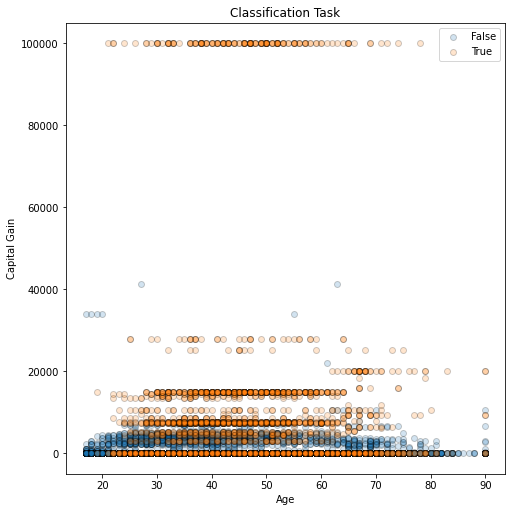

In [4]:
fig, ax = plt.subplots(figsize=(7, 7), constrained_layout=True)
plot_decision_boundary(X, y, 'Classification Task', feature_names,
                       X_display=display_data, idx_x=0, idx_y=8, fig=fig, ax=ax, alpha=0.2)

In [5]:
feature_names

array(['Age', 'Workclass', 'Education-Num', 'Marital Status',
       'Occupation', 'Relationship', 'Race', 'Sex', 'Capital Gain',
       'Capital Loss', 'Hours per week', 'Country'], dtype=object)

In [6]:
feature_names[8]

'Capital Gain'

In [7]:
%%time
class MyModifiedClassifier(ModifiedClassifier):
    def _preprocess(self, X):
        X2 = X.copy()
        X2[:, 8] += 7500
        return X2

clf_a = LogisticRegression(C=1.0, max_iter=10000)
clf_a.fit(X, y)
clf_b = MyModifiedClassifier(clf_a)
clf_b.fit(X, y)
comparer = ModelComparer(clf_a, clf_b, feature_names)
comparer.fit(X, y)
with open(task_name + '.models', 'wb') as f:
    cloudpickle.dump(comparer, f, pickle.HIGHEST_PROTOCOL)

CPU times: user 15.7 s, sys: 1.28 s, total: 17 s
Wall time: 9.86 s


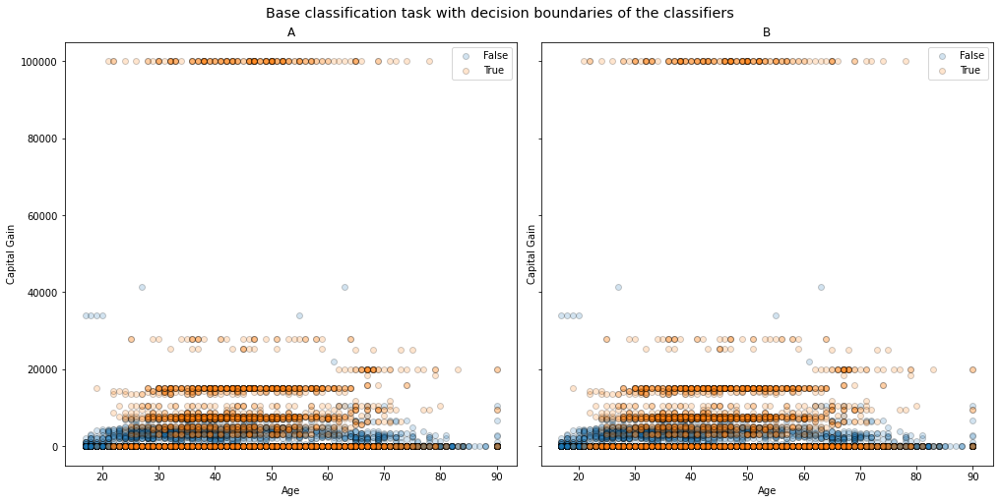

In [8]:
comparer.plot_individual_clf_decision_boundaries(X, display_data, y, kind='label', idx_x=0, idx_y=8, alpha=0.2)

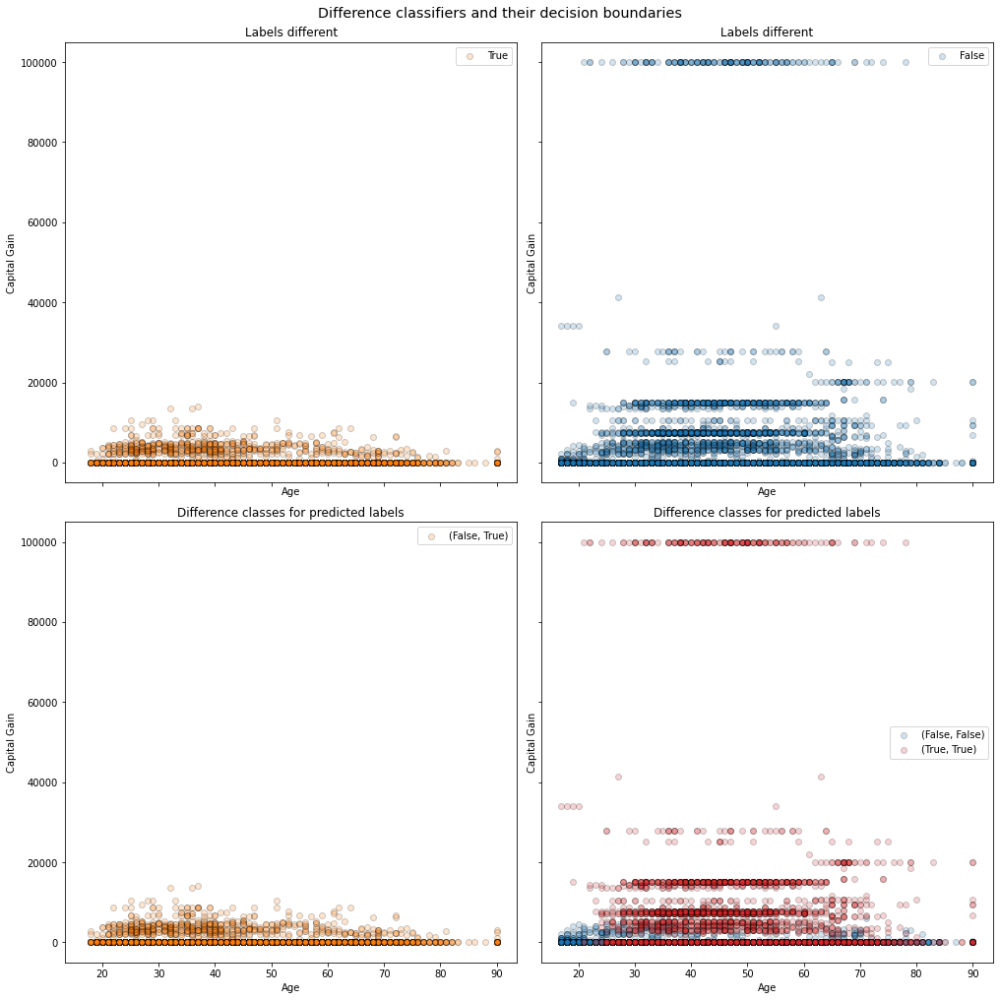

In [9]:
comparer.plot_decision_boundaries(X, display_data, kind='label', idx_x=0, idx_y=8, separate=True, alpha=0.2)

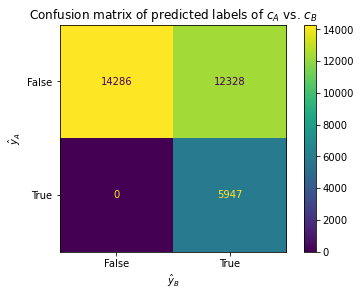

In [10]:
comparer.plot_confusion_matrix(X)

# Explain using Interpretability Methods

In [11]:
if sample_explain_data is not None:
    # stratified sample across diff classes
    mclass_diff = comparer.predict_mclass_diff(X)
    X_explain, display_data_explain, y_explain = resample(X, display_data, y,
                                                          n_samples=sample_explain_data, replace=False,
                                                          stratify=mclass_diff, random_state=0)
    comparer.plot_confusion_matrix(X_explain)
else:
    X_explain, display_data_explain, y_explain = X, display_data, y

In [12]:
%%time
explanations = generate_shap_explanations(comparer, X_explain, display_data_explain)
with open(task_name + '.expl', 'wb') as f:
    pickle.dump(explanations, f, pickle.HIGHEST_PROTOCOL)

divide by zero encountered in log
divide by zero encountered in log
divide by zero encountered in log
filtering instances with nonfinite predictions: [ 1246  1616  2319  2707  3105  3368  5098  5473  5588  7629  8710  8742
 10771 10964 12141 12677 14117 14238 14579 15279 16422 16740 18080 18408
 18463 18654 18882 19900 20283 21188 22361 23087 23467 23678 24510 24850
 24983 25633 26083 26442 28264 28294 28349 29806 30244 30913]
Permutation explainer: 32516it [03:32, 148.08it/s]                           
Permutation explainer: 32516it [03:43, 138.80it/s]                           
Permutation explainer: 32516it [03:28, 148.72it/s]                           
Permutation explainer: 32516it [03:39, 141.34it/s]                           
Permutation explainer:  18%|█▊        | 5994/32515 [00:52<03:50, 114.92it/s]divide by zero encountered in log
invalid value encountered in subtract
invalid value encountered in subtract
divide by zero encountered in log
invalid value encountered in subtract

CPU times: user 1h 46min 15s, sys: 9min 50s, total: 1h 56min 5s
Wall time: 59min 22s


## Visualize SHAP values

### Individual explanations

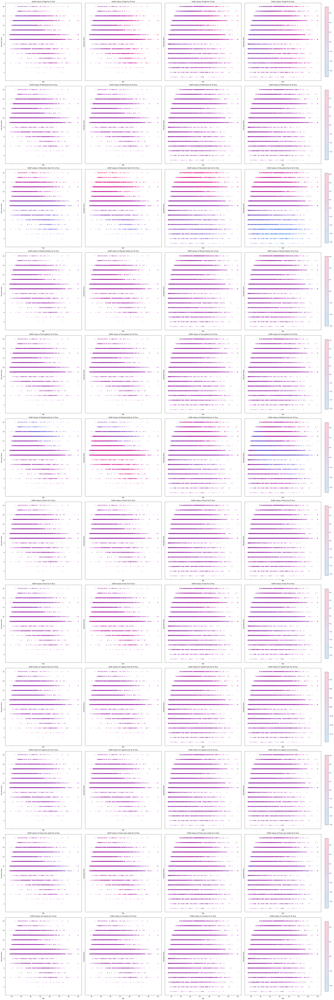

In [13]:
is_pred_diff = comparer.predict_bin_diff(explanations.data)
plot_2d(explanations.indiv.labels[is_pred_diff, :, 1], explanations.indiv.labels[~is_pred_diff, :, 1], x='Age', y='Education-Num', alpha=0.2)

### Simple subtraction explanation

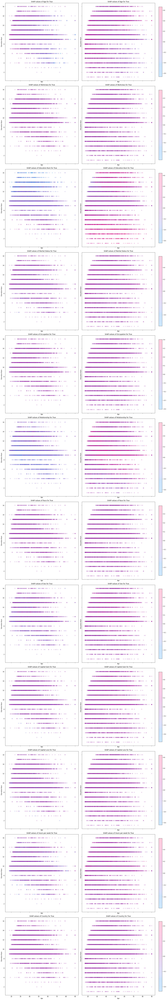

In [14]:
plot_2d(explanations.indiv_diff.labels[is_pred_diff, :, 'True'], explanations.indiv_diff.labels[~is_pred_diff, :, 'True'], x='Age', y='Education-Num', alpha=0.2)

### Multiclass difference classifier explanations

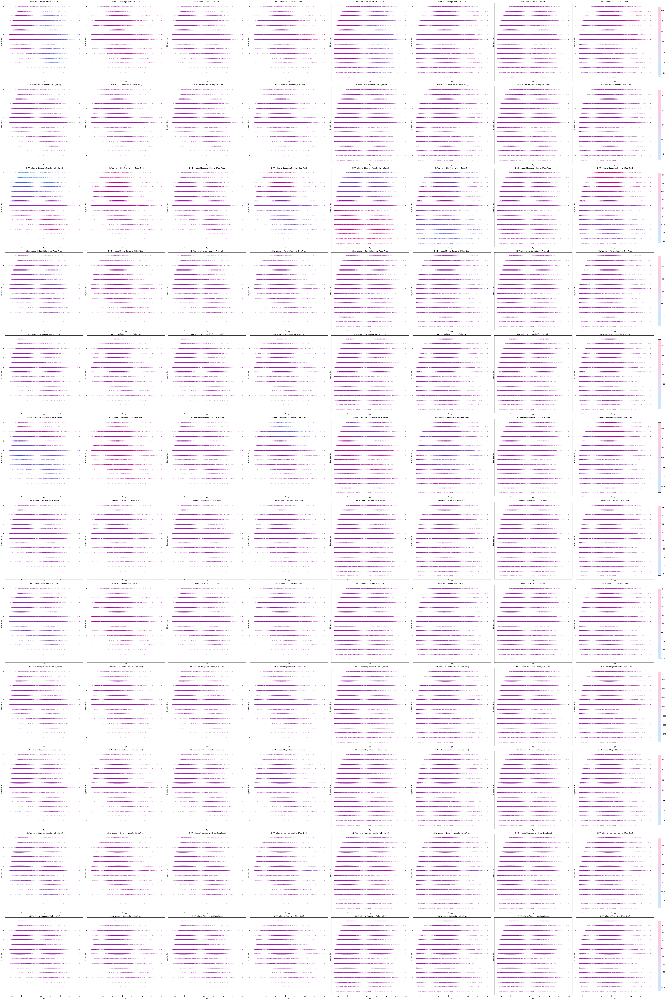

In [15]:
plot_2d(explanations.mclass_diff.labels[is_pred_diff], explanations.mclass_diff.labels[~is_pred_diff], x='Age', y='Education-Num', alpha=0.2)

## Feature importance

### Individual explanations

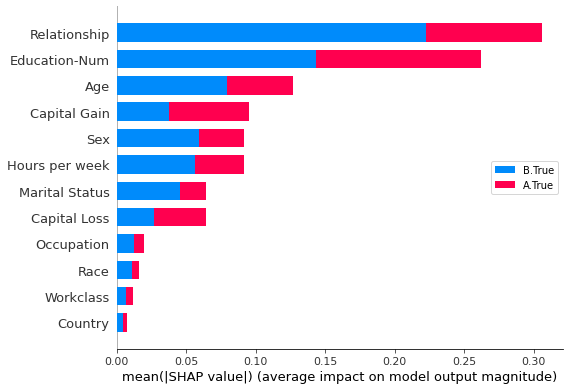

In [16]:
plot_feature_importance_bar(explanations.indiv.labels[:, :, 1])

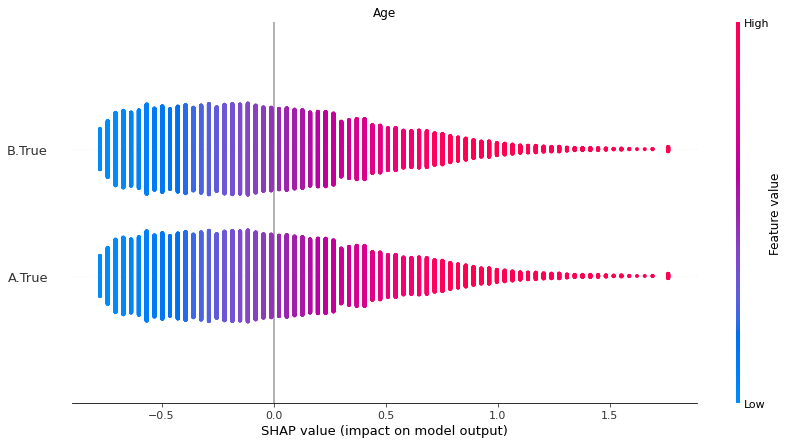

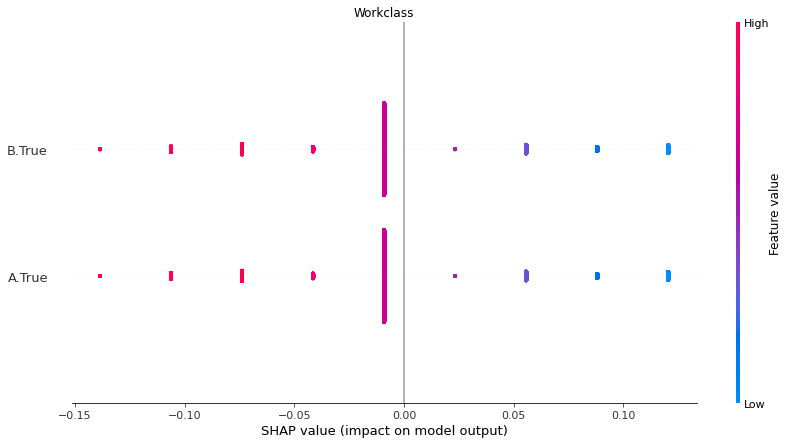

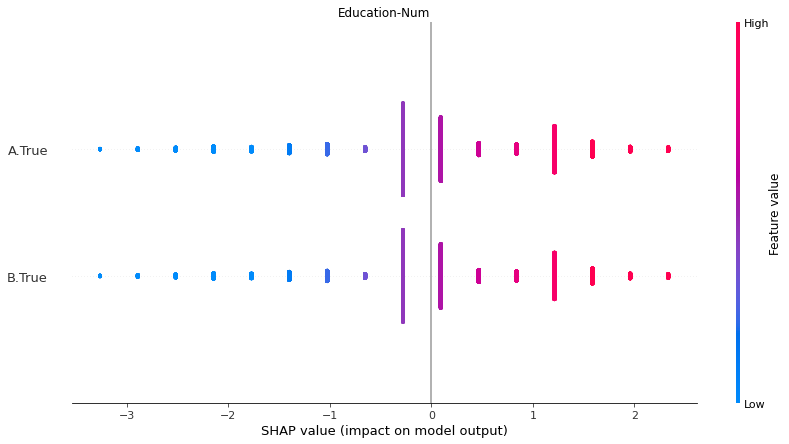

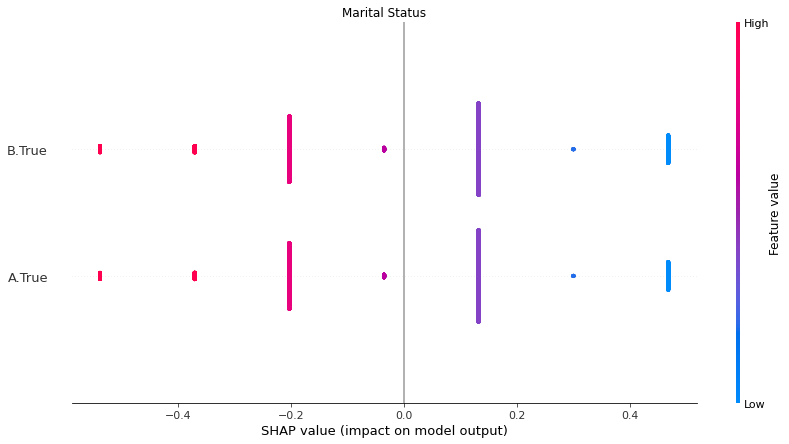

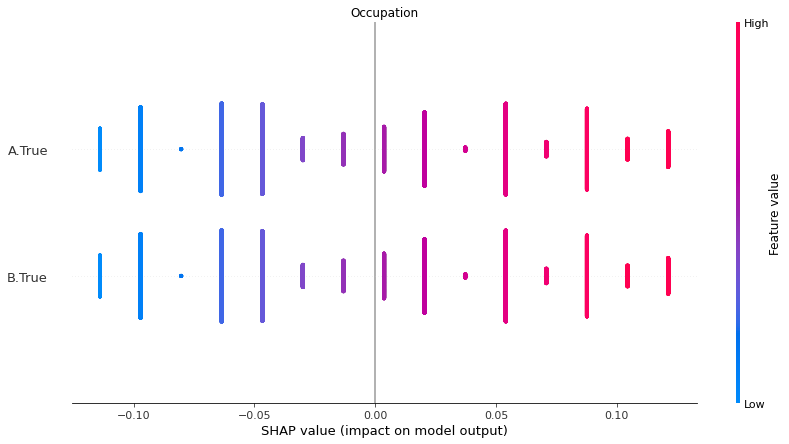

...

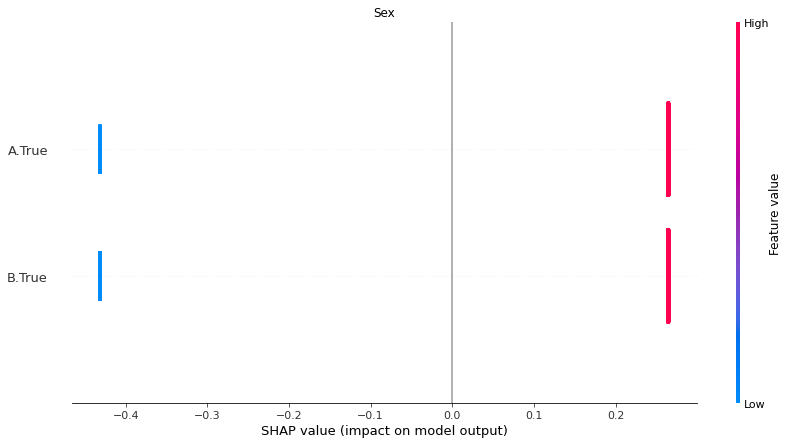

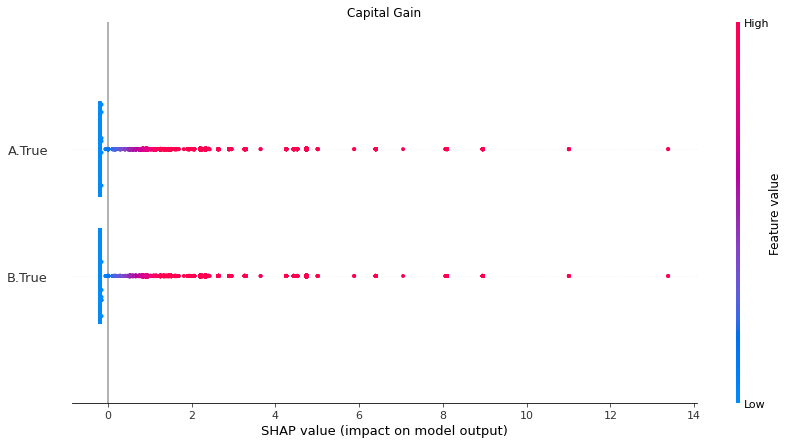

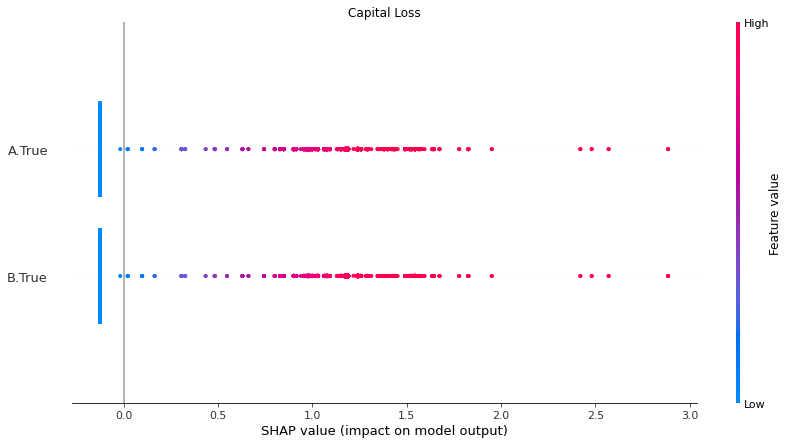

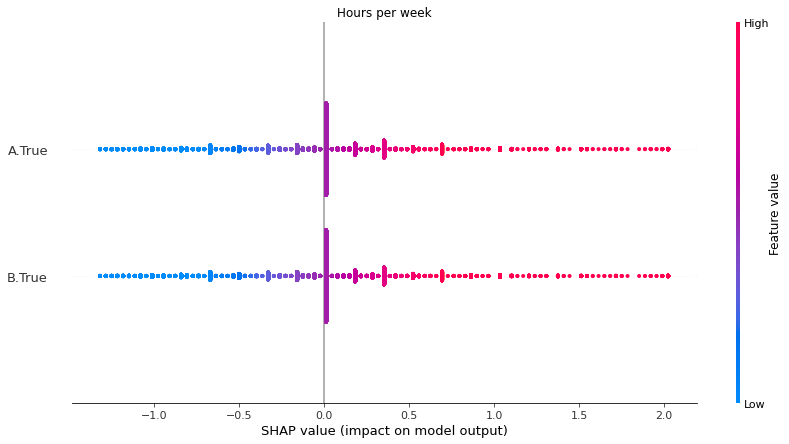

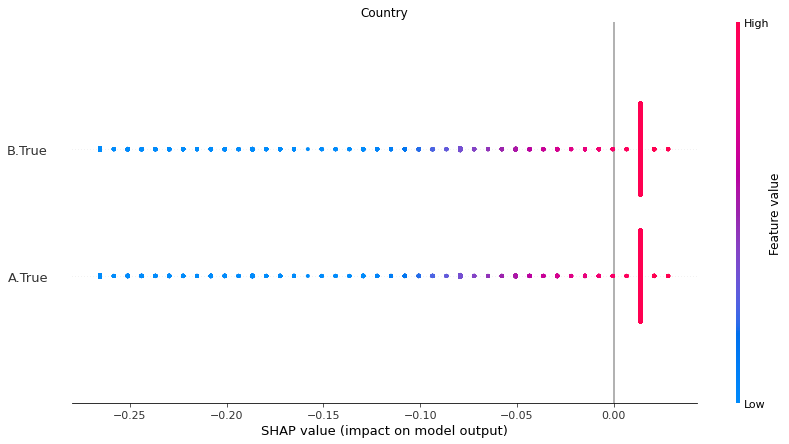

In [17]:
plot_feature_importance_scatter(explanations.indiv.log_odds[:, :, 1])

### Simple subtraction explanation

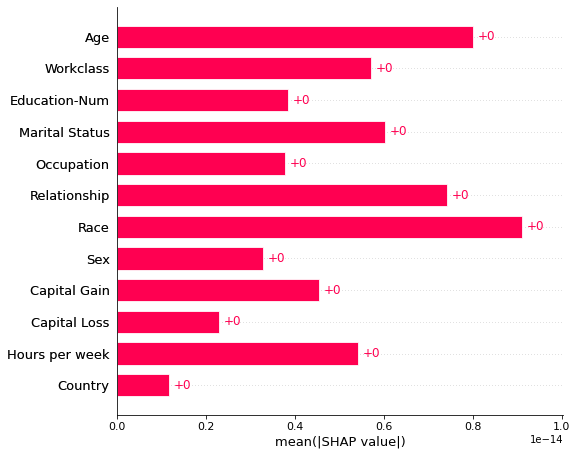

In [18]:
plot_feature_importance_bar(explanations.indiv_diff.log_odds[:, :, 1])

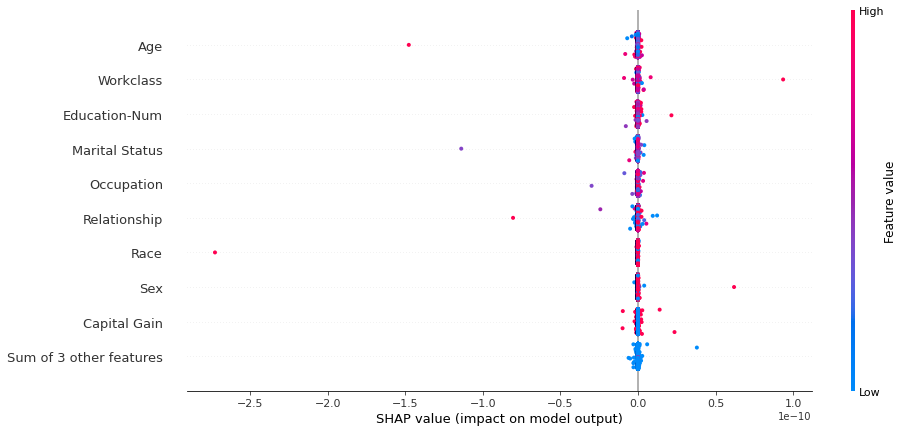

In [19]:
plot_feature_importance_scatter(explanations.indiv_diff.log_odds[:, :, 1])

### Multiclass difference classifier explanations

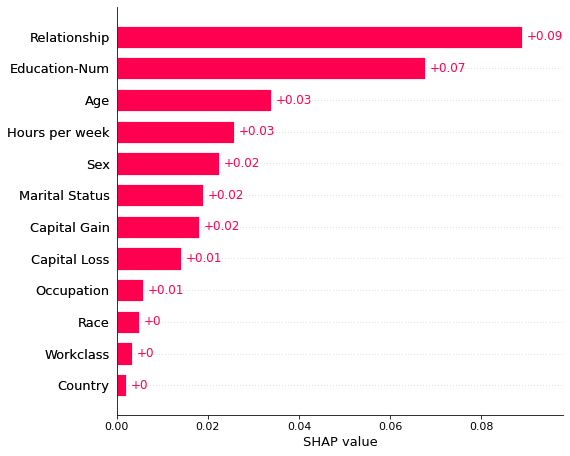

In [20]:
feature_order, feature_importance = calc_feature_order(explanations.mclass_diff.labels[:, :, comparer.difference_class_names])
plot_feature_importance_bar(feature_importance)

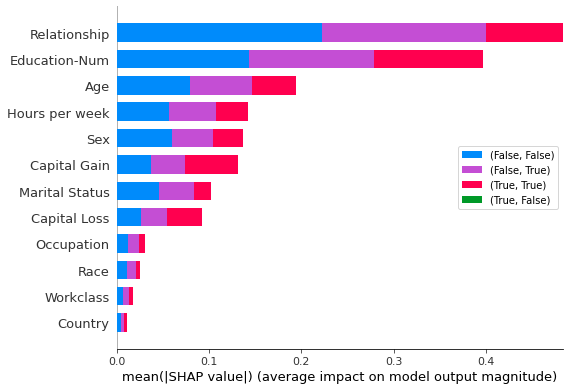

In [21]:
plot_feature_importance_bar(explanations.mclass_diff.labels)

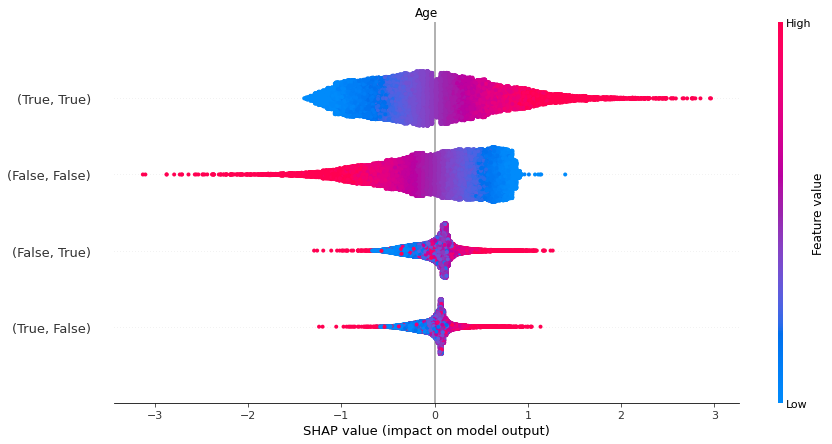

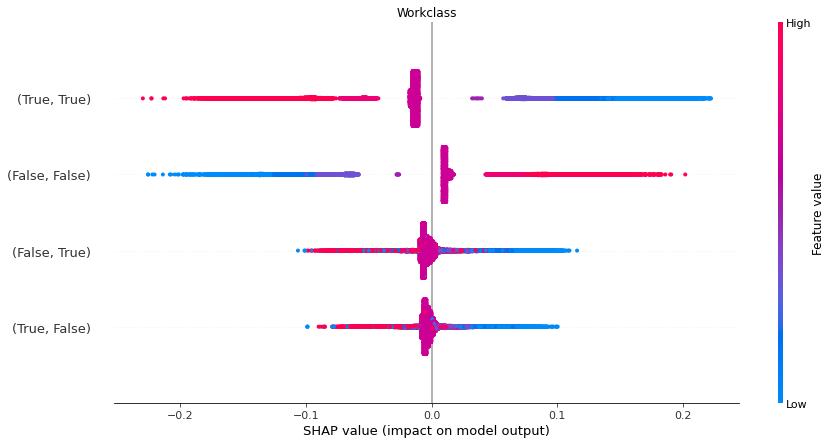

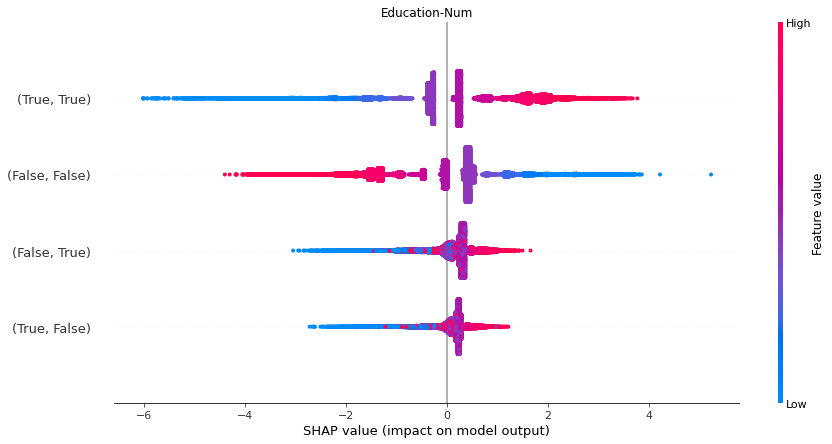

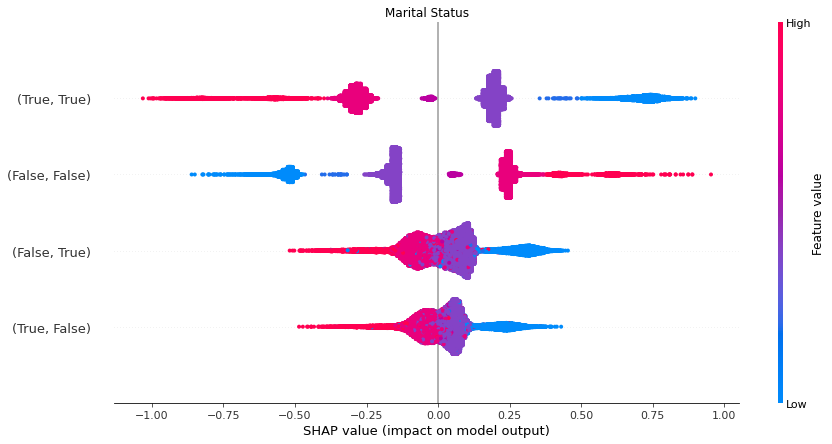

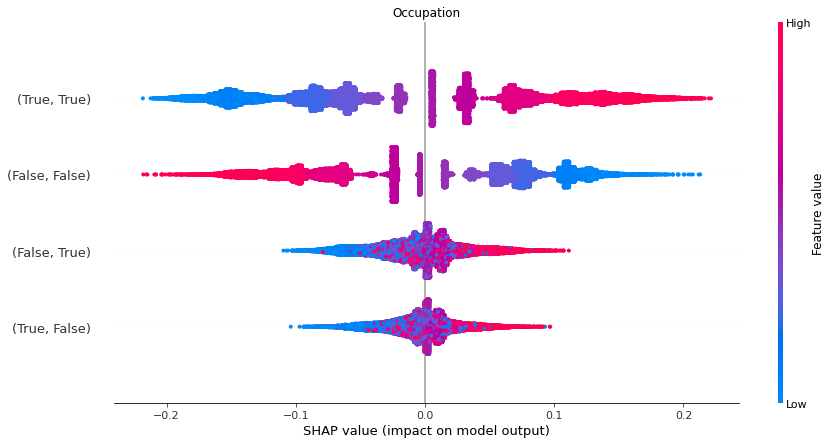

...

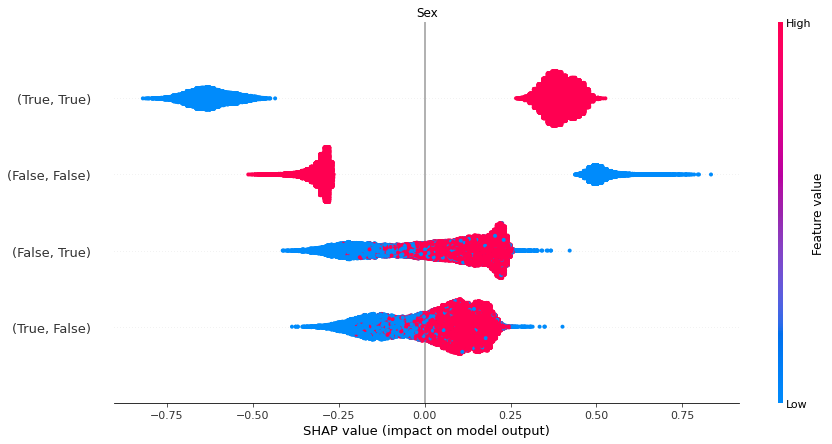

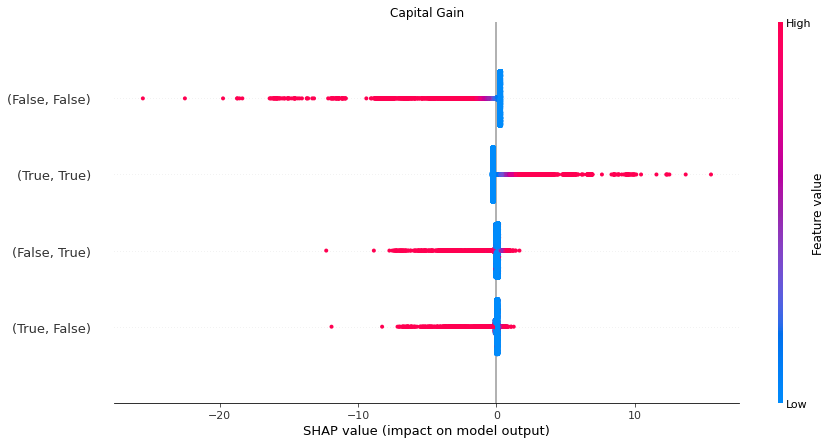

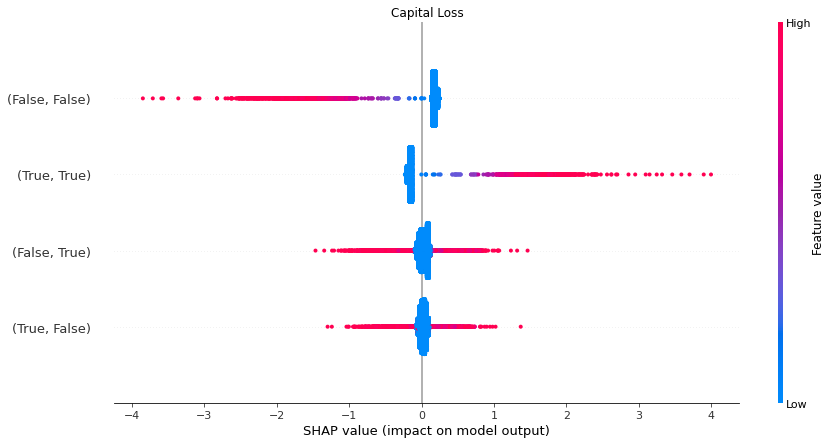

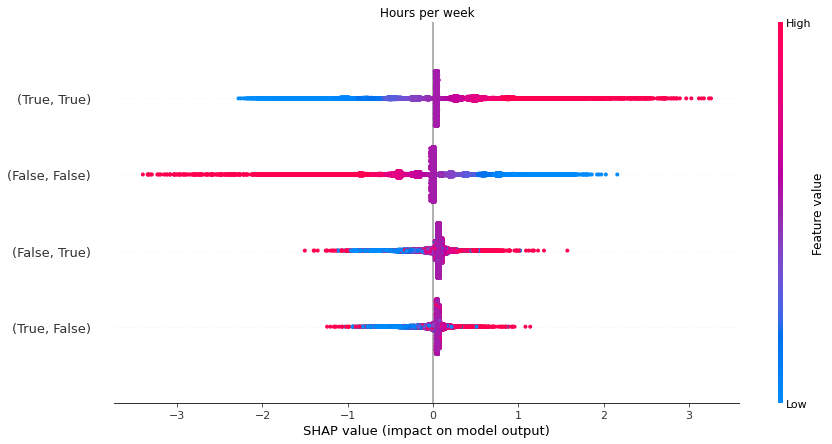

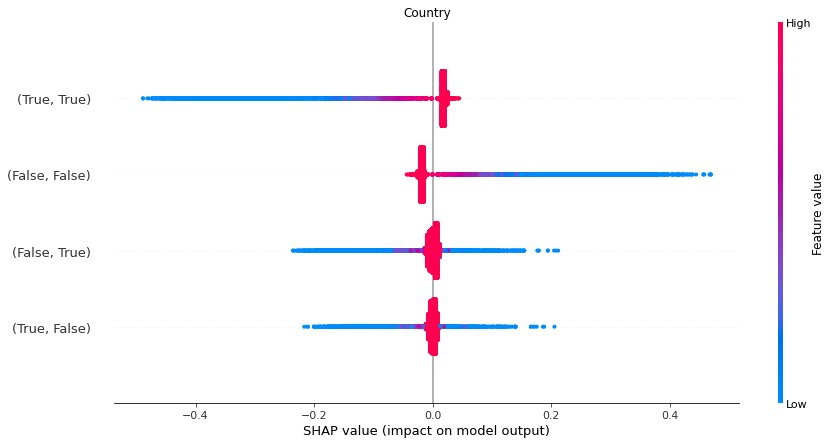

In [22]:
plot_feature_importance_scatter(explanations.mclass_diff.log_odds)

## Feature effects

### Individual explanations

Passing the fontdict parameter of _set_ticklabels() positionally is deprecated since Matplotlib 3.3; the parameter will become keyword-only two minor releases later.


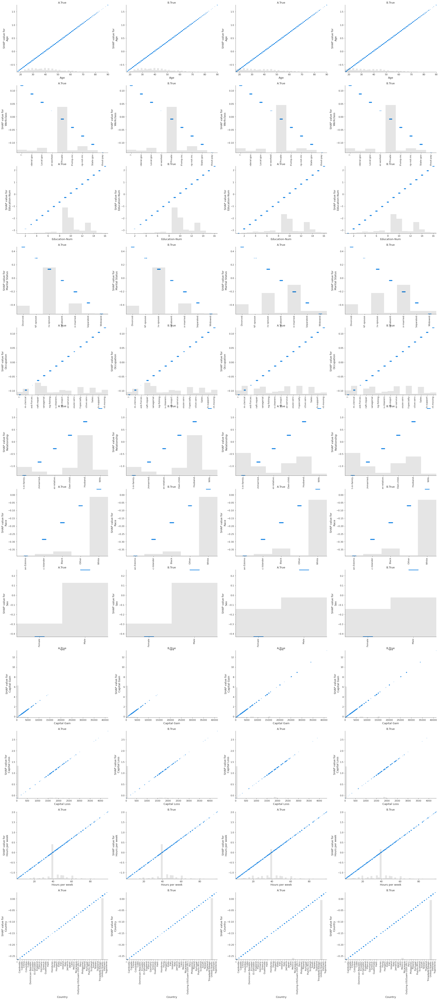

In [23]:
is_pred_diff = comparer.predict_bin_diff(explanations.data)
plot_feature_effects(explanations.indiv.log_odds[is_pred_diff, :, 1], explanations.indiv.log_odds[~is_pred_diff, :, 1], alpha=0.2)

### Simple subtraction explanation

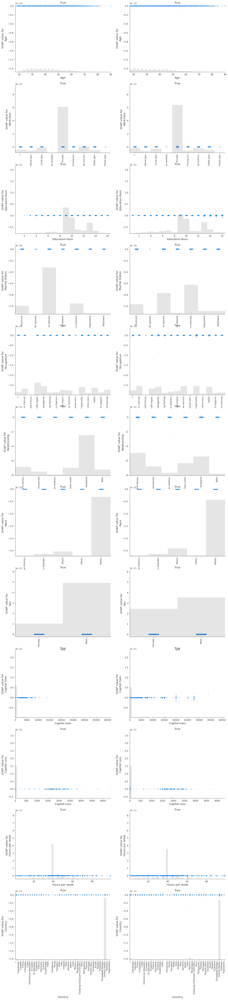

In [24]:
plot_feature_effects(explanations.indiv_diff.log_odds[is_pred_diff, :, 1], explanations.indiv_diff.log_odds[~is_pred_diff, :, 1], alpha=0.2)

### Multiclass difference classifier explanations

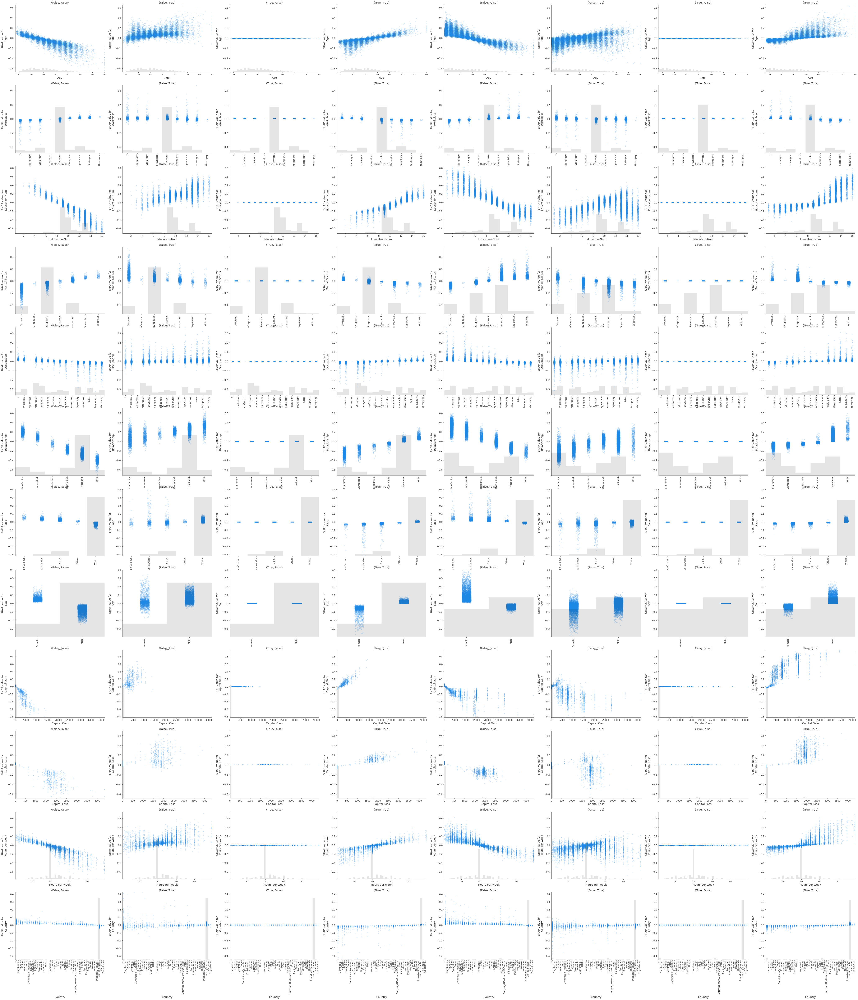

In [25]:
plot_feature_effects(explanations.mclass_diff.labels[is_pred_diff], explanations.mclass_diff.labels[~is_pred_diff], alpha=0.2)

## Cluster instances

### Individual explanations

In [26]:
n_samples = 1000
if explanations.shape[0] > n_samples:
    is_pred_diff = comparer.predict_bin_diff(explanations.data)
    is_pred_diff_indices = np.where(is_pred_diff)[0]
    is_pred_equal_indices = np.where(~is_pred_diff)[0]
    if len(is_pred_diff_indices) > n_samples/2:
        is_pred_diff_indices = resample(is_pred_diff_indices, replace=False, n_samples=int(n_samples/2), random_state=0)
    if len(is_pred_equal_indices) > n_samples/2:
        is_pred_equal_indices = resample(is_pred_equal_indices, replace=False, n_samples=int(n_samples/2), random_state=0)
    sample_indices = np.concatenate([is_pred_diff_indices, is_pred_equal_indices])
    explanations_sample = explanations[sample_indices]
else:
    explanations_sample = explanations

In [27]:
instance_order = calc_instance_order(explanations_sample)

In [28]:
plot_forces(explanations_sample.indiv.proba[:, :, 1], instance_order=instance_order)

### Simple subtraction explanation

In [29]:
plot_forces(explanations_sample.indiv_diff.proba, instance_order=instance_order)

### Multiclass difference classifier explanations

In [30]:
plot_forces(explanations_sample.bin_diff.labels, instance_order=instance_order)

In [31]:
plot_forces(explanations_sample.mclass_diff.proba[:, :, comparer.difference_class_names], instance_order=instance_order)